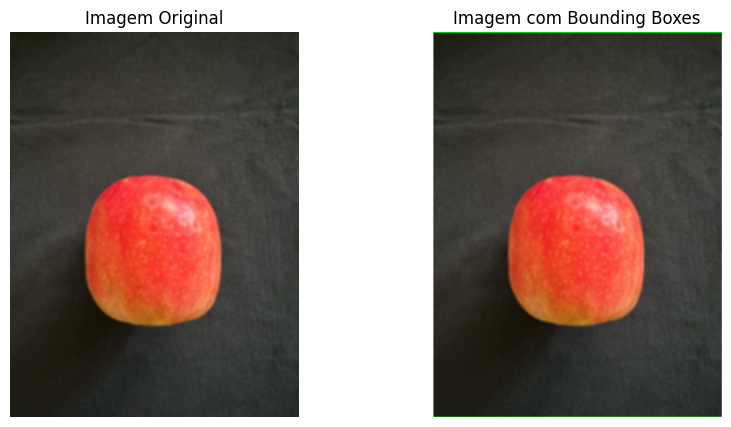

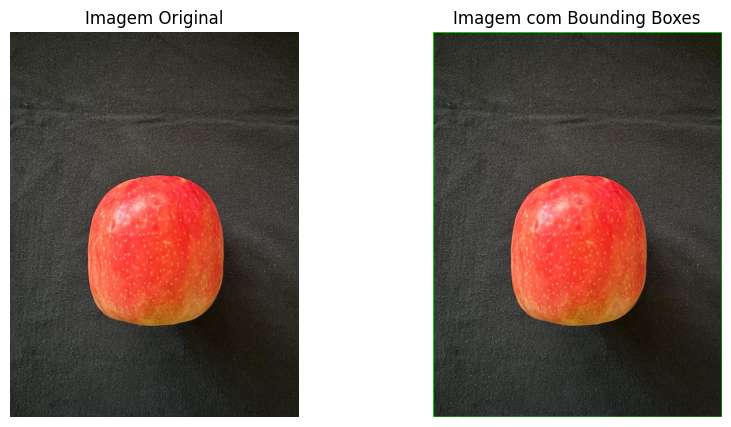

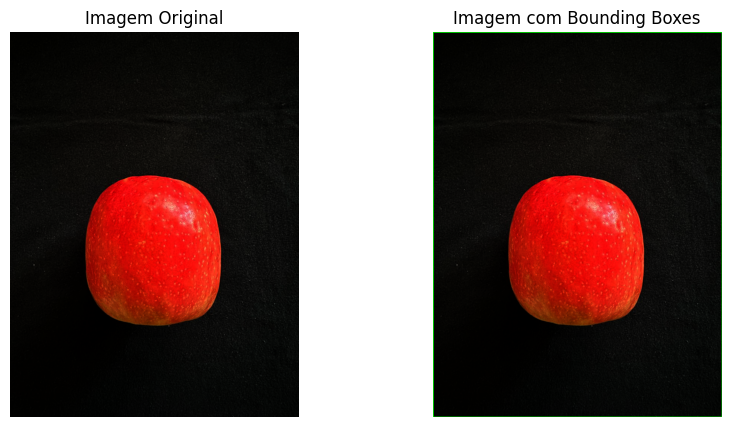

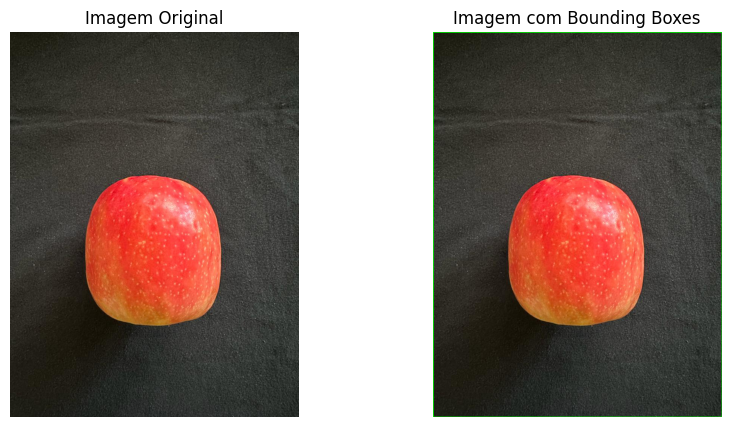

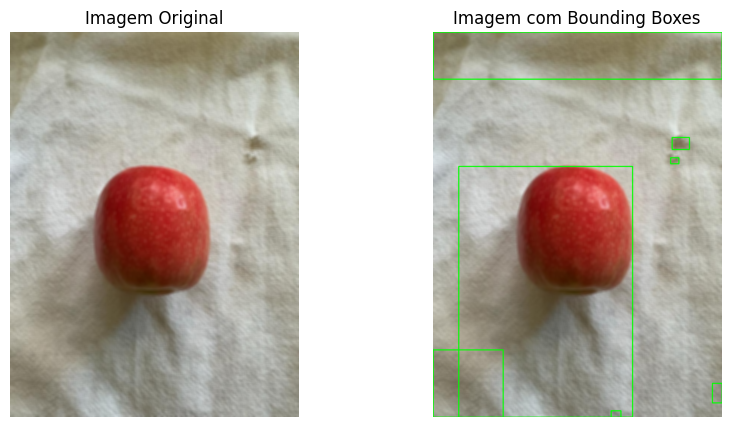

...

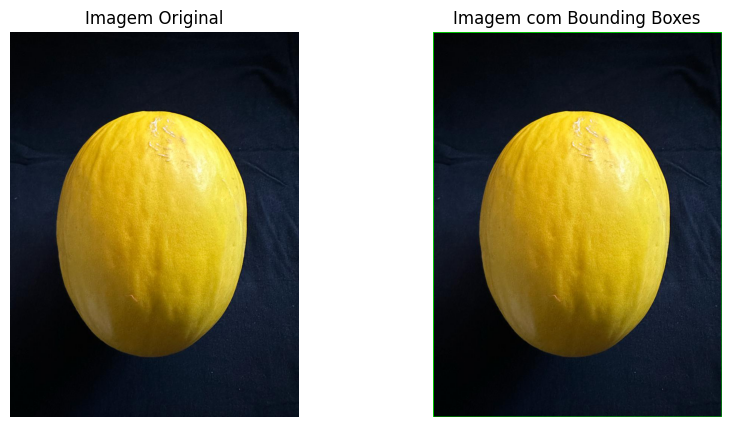

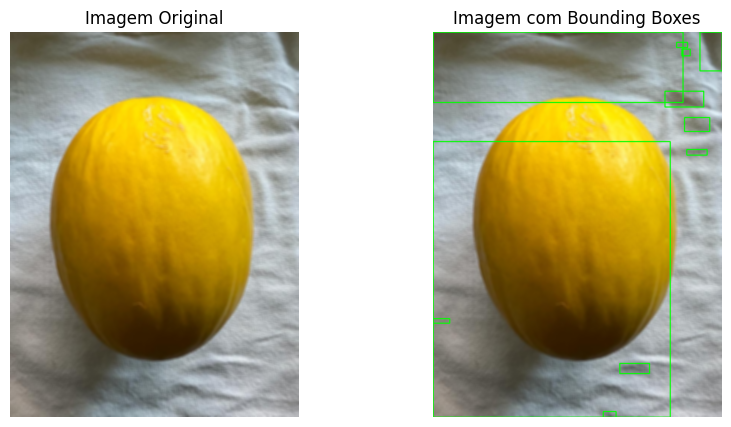

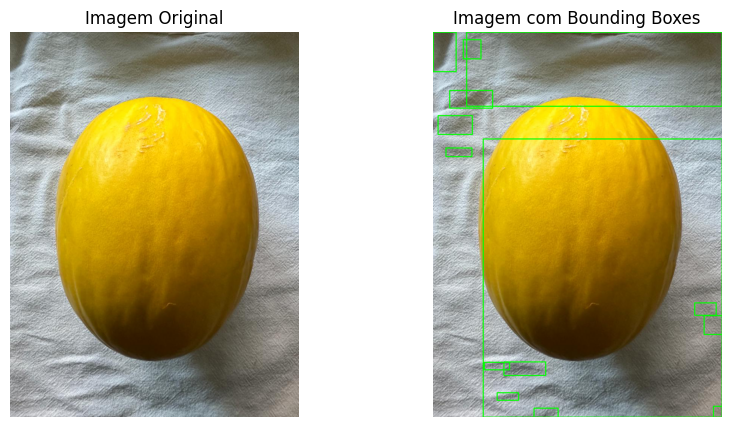

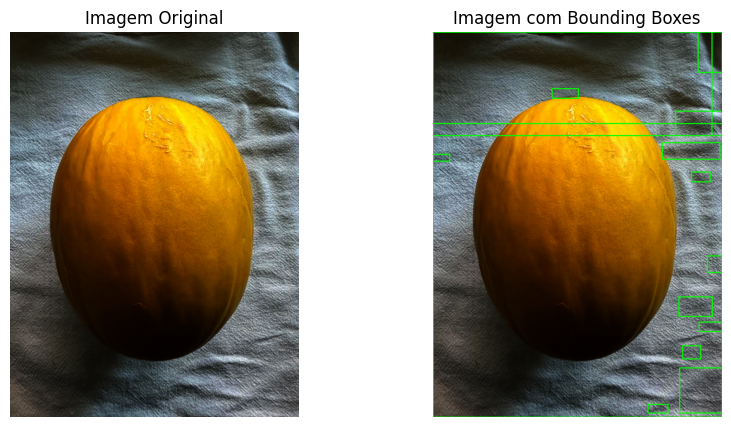

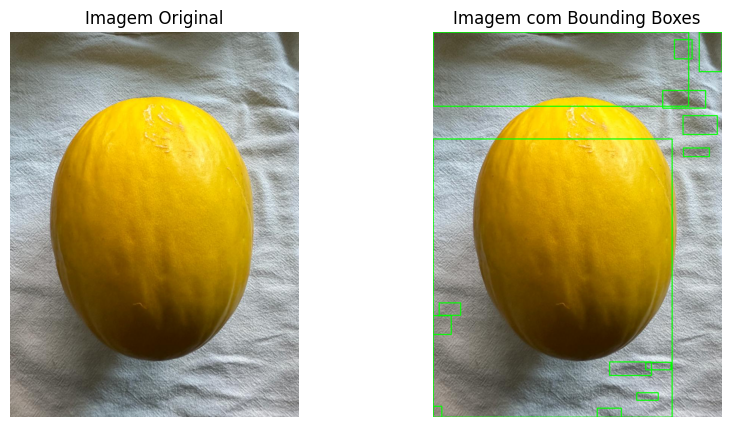

In [13]:
import os
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt

# Definir as classes de frutas
fruit_classes = ['Apple', 'Banana', 'Pineapple', 'Orange', 'Pear', 'Kiwi_fruit', 'Avocado', 'Dragon_fruit', 'Lemon', 'Melon']

# Obter o diretório atual do modelo
base_dir = os.getcwd()

# Definir o caminho para a pasta que contém as imagens de frutas
images_dir = os.path.join(base_dir, 'FrutasProcessadas')

# Percorrer as classes de frutas
for fruit_class in fruit_classes:
    class_dir = os.path.join(images_dir, fruit_class)
    # Percorrer as imagens da classe de fruta
    for image_name in os.listdir(class_dir):
        image_path = os.path.join(class_dir, image_name)
        
        # Eu achei que era para fazer com as mascaras, mas não funcionou de qualquer forma
        if "mask" in image_name and image_name.endswith('.png'):
            # Ler a imagem em escala de cinza
            image = Image.open(image_path).convert('L')
        else:
            # Ler a imagem em cores
            image = Image.open(image_path).convert('RGB')
        
        if image is not None:
            # Converter a imagem para um array numpy
            image_array = np.array(image)
            
            # Converter a imagem para escala de cinza
            if len(image_array.shape) > 2:
                image_gray = cv2.cvtColor(image_array, cv2.COLOR_RGB2GRAY)
            else:
                image_gray = image_array
            
            _, threshold_image_array = cv2.threshold(image_gray, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
            contours, _ = cv2.findContours(threshold_image_array, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            image_with_boxes = image_array.copy()
            
            # Percorrer os contornos e desenhar as bounding boxes
            for contour in contours:
                area = cv2.contourArea(contour)
                
                # Definir uma área mínima para considerar um contorno como válido
                min_area = 150
                
                if area > min_area:
                    x, y, w, h = cv2.boundingRect(contour)
                    cv2.rectangle(image_with_boxes, (x, y), (x+w, y+h), (0, 255, 0), 2)
            
            # Exibir a imagem original e a imagem com as bounding boxes
            fig, axes = plt.subplots(1, 2, figsize=(10, 5))
            axes[0].imshow(image_array, cmap='gray' if len(image_array.shape) < 3 else None)
            axes[0].set_title('Imagem Original')
            axes[0].axis('off')
            axes[1].imshow(image_with_boxes)
            axes[1].set_title('Imagem com Bounding Boxes')
            axes[1].axis('off')
            plt.show()
        else:
            print(f"Erro ao ler a imagem: {image_path}")
